In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
df=pd.read_parquet(r"C:\Users\Ahmed\Desktop\PROJECT\store-sales-time-series-forecasting",engine='pyarrow')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2061903 entries, 0 to 2061902
Data columns (total 16 columns):
 #   Column         Dtype         
---  ------         -----         
 0   date           datetime64[ns]
 1   store_nbr      int64         
 2   family         string        
 3   unit_sales     float64       
 4   onpromotion    int8          
 5   city           string        
 6   state          string        
 7   store_type     string        
 8   perishable     int8          
 9   transactions   int64         
 10  oil_price      float64       
 11  day_type       string        
 12  Event Scale    string        
 13  locale_name    string        
 14  temperature    float64       
 15  precipitation  float64       
dtypes: datetime64[ns](1), float64(4), int64(2), int8(2), string(7)
memory usage: 224.2 MB


In [4]:
df.columns

Index(['date', 'store_nbr', 'family', 'unit_sales', 'onpromotion', 'city',
       'state', 'store_type', 'perishable', 'transactions', 'oil_price',
       'day_type', 'Event Scale', 'locale_name', 'temperature',
       'precipitation'],
      dtype='object')

In [5]:
df[['day_type']]

,day_type
0,Work Day
1,Work Day
2,Work Day
3,Work Day
4,Work Day
...,...
2061898,Work Day
2061899,Work Day
2061900,Work Day
2061901,Work Day


In [6]:
random_row = df['day_type'].sample(n=50)
random_row 

156095       Work Day
1289432      Work Day
1421290       Holiday
110398       Work Day
179882       Work Day
37910        Work Day
300793       Work Day
118621       Work Day
404138        Holiday
1854046      Work Day
664725       Work Day
999025       Work Day
181024       Work Day
290110       Work Day
797525       Work Day
1089052      Work Day
1809406      Work Day
1969613      Work Day
1243674      Work Day
673101       Work Day
726173       Work Day
49757        Work Day
1400469       Holiday
953248       Work Day
411867       Work Day
1342766      Work Day
1996388    Additional
1035780         Event
111066       Work Day
1714165      Transfer
1070892      Work Day
1917302      Work Day
183083       Work Day
1759193       Holiday
1586287      Work Day
232279       Work Day
1072774      Work Day
81229        Work Day
25776        Work Day
722035       Work Day
398538       Work Day
196772       Work Day
1581210      Work Day
956918       Work Day
1124617         Event
208585    

In [7]:
random_row1 = df['precipitation'].sample(n=20)
random_row1

1101713     6.6
1530893     0.4
624761      0.3
866975     10.5
1002002     6.3
975792     29.9
52967       9.1
195504     16.4
201817      1.6
1930707     1.5
518220     13.9
1725683     1.6
129562      3.2
803149      7.8
1092190    10.9
1982466     2.4
1567586     1.6
1330676    11.8
1893417     0.0
82591       4.6
Name: precipitation, dtype: float64

In [8]:
df.dtypes

date             datetime64[ns]
store_nbr                 int64
family           string[python]
unit_sales              float64
onpromotion                int8
city             string[python]
state            string[python]
store_type       string[python]
perishable                 int8
transactions              int64
oil_price               float64
day_type         string[python]
Event Scale      string[python]
locale_name      string[python]
temperature             float64
precipitation           float64
dtype: object

In [9]:
df.shape

(2061903, 16)

In [10]:
df.head()

,date,store_nbr,family,unit_sales,onpromotion,city,state,store_type,perishable,transactions,oil_price,day_type,Event Scale,locale_name,temperature,precipitation
0,2016-02-18,29,HOME APPLIANCES,1.000,0,Guayaquil,Guayas,E,0,965,30.77,Work Day,Non,Non,26.7,7.6
1,2016-02-18,29,HOME AND KITCHEN II,16.000,0,Guayaquil,Guayas,E,0,7720,30.77,Work Day,Non,Non,26.7,7.6
2,2016-02-18,30,PRODUCE,499.029,0,Guayaquil,Guayas,C,1,55350,30.77,Work Day,Non,Non,26.7,7.6
3,2016-02-18,31,GROCERY II,10.000,0,Babahoyo,Los Rios,B,0,3702,30.77,Work Day,Non,Non,25.7,13.4
4,2016-02-18,32,CLEANING,407.000,0,Guayaquil,Guayas,C,0,86196,30.77,Work Day,Non,Non,26.7,7.6


In [11]:
df['date'].value_counts

<bound method IndexOpsMixin.value_counts of 0         2016-02-18
1         2016-02-18
2         2016-02-18
3         2016-02-18
4         2016-02-18
             ...    
2061898   2015-02-11
2061899   2015-02-11
2061900   2015-02-11
2061901   2015-02-11
2061902   2015-02-11
Name: date, Length: 2061903, dtype: datetime64[ns]>

In [12]:
df['date'].dt.month.unique()

array([ 2,  3,  4,  5, 10, 11, 12,  1,  6,  7,  8,  9], dtype=int32)

In [13]:
df['date'].dt.year.unique()

array([2016, 2017, 2015, 2014, 2013], dtype=int32)

In [14]:
df['date'].dt.day.unique()

array([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,  1,  2,  3,  4,  5,
        6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 30, 31],
      dtype=int32)

In [15]:
df.isnull().sum()

date             0
store_nbr        0
family           0
unit_sales       0
onpromotion      0
city             0
state            0
store_type       0
perishable       0
transactions     0
oil_price        0
day_type         0
Event Scale      0
locale_name      0
temperature      0
precipitation    0
dtype: int64

In [16]:
df.duplicated().sum()

np.int64(0)

In [17]:
df.describe()

,date,store_nbr,unit_sales,onpromotion,perishable,transactions,oil_price,temperature,precipitation
count,2061903,2.061903e+06,2.061903e+06,2.061903e+06,2.061903e+06,2.061903e+06,2.061903e+06,2.061903e+06,2.061903e+06
mean,2015-07-25 07:36:13.662484992,2.704447e+01,5.318069e+02,3.700320e-02,3.509835e-01,1.167683e+05,6.362070e+01,1.725718e+01,8.043702e+00
min,2013-01-01 00:00:00,1.000000e+00,-1.224000e+04,0.000000e+00,0.000000e+00,0.000000e+00,2.619000e+01,-9.700000e+00,0.000000e+00
25%,2014-07-09 00:00:00,1.300000e+01,9.000000e+00,0.000000e+00,0.000000e+00,5.584000e+03,4.797000e+01,1.250000e+01,1.400000e+00
50%,2015-09-13 00:00:00,2.700000e+01,7.909900e+01,0.000000e+00,0.000000e+00,2.053600e+04,6.048322e+01,1.400000e+01,4.900000e+00
75%,2016-09-03 00:00:00,4.100000e+01,3.932685e+02,0.000000e+00,1.000000e+00,8.890000e+04,6.829886e+01,2.380000e+01,1.110000e+01
max,2017-08-15 00:00:00,5.400000e+01,1.748770e+05,1.000000e+00,1.000000e+00,1.413600e+07,1.106200e+02,2.800000e+01,1.961000e+02
std,NaN,1.581968e+01,1.358049e+03,1.887696e-01,4.772779e-01,3.042494e+05,2.050066e+01,6.514149e+00,1.025074e+01


In [18]:
#Check negative values
print("Negative values in unit_sales:", df[df['unit_sales'] < 0]['unit_sales'].count())

df = df[(df['unit_sales'] >= 0)]

df.shape

Negative values in unit_sales: 116


(2061787, 16)

In [19]:
df['date'] = pd.to_datetime(df['date'])
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day
df['weekday'] = df['date'].dt.weekday

In [20]:
# Group data by date and sum unit sales
sales_trend = df.groupby('date')['unit_sales'].sum().reset_index()

# Create the line plot
fig = px.line(sales_trend, x='date', y='unit_sales', title='Total Sales Trend (2013-2017)')

# Customize the layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Unit Sales',
    xaxis_tickangle=45,
    width=1200,  
    height=600,
    margin=dict(l=40, r=40, t=40, b=40)  
)

fig.show()

In [21]:
years = range(2013, 2018)

# Create subplot figure with one row per year
fig = make_subplots(
    rows=len(years),
    cols=1,
    subplot_titles=[f'Sales Trend - {year}' for year in years],
    vertical_spacing=0.1
)

# Sales Trend Over Time
for i, year in enumerate(years):
    # Filter and group data for the specific year
    yearly_data = df[df['date'].dt.year == year].groupby('date')['unit_sales'].sum().reset_index()
    
    # Add trace for the year's sales trend
    fig.add_trace(
        go.Scatter(
            x=yearly_data['date'],
            y=yearly_data['unit_sales'],
            mode='lines',
            name=f'Sales {year}',
            line=dict(color='blue')
        ),
        row=i+1,  
        col=1
    )

# Update layout for all subplots
fig.update_layout(
    height=300 * len(years),  
    width=900,
    showlegend=False,  
    template='plotly_white'
)

# Update axes for each subplot
for i in range(len(years)):
    fig.update_xaxes(
        title_text='Date',
        tickangle=45,
        type='date',  
        row=i+1,
        col=1
    )
    fig.update_yaxes(
        title_text='Unit Sales',
        row=i+1,
        col=1
    )

fig.show()

In [22]:
# Group by 'family', sum 'unit_sales', and get the top 20
top_20_families = df.groupby('family')['unit_sales'].sum().sort_values(ascending=True).tail(20)

# Create a DataFrame for Plotly
plot_df = top_20_families.reset_index()

fig = px.bar(
    plot_df,
    x='unit_sales',
    y='family',
    orientation='h',  
    title='Total Sales by Product Family (Top 20)',
    labels={'unit_sales': 'Unit Sales', 'family': 'Product Family'}
)

# Update layout for better appearance
fig.update_layout(
    width=1200,  
    height=800,
    xaxis_title='Unit Sales',
    yaxis_title='Product Family',
    showlegend=False,
    margin=dict(l=50, r=50, t=100, b=50)  
)

fig.show()

In [23]:
# Aggregate data: sum of unit_sales by onpromotion
agg_data = df.groupby('onpromotion')['unit_sales'].sum().reset_index()

fig = px.bar(
    agg_data,
    x='onpromotion',
    y='unit_sales',
    title='Total Sales: Promotion vs No Promotion',
    labels={'unit_sales': 'Total Unit Sales', 'onpromotion': 'On Promotion'}
)

# Update layout and customize
fig.update_layout(
    width=800,  
    height=600,
    xaxis_title='On Promotion',
    yaxis_title='Total Unit Sales',
    xaxis=dict(
        tickvals=[0, 1],
        ticktext=['No', 'Yes']  # Replace 0/1 with No/Yes
    ),
    showlegend=False,
    margin=dict(l=50, r=50, t=100, b=50)  # Tight layout equivalent
)

# Show the plot
fig.show()

In [24]:
numeric_cols = ['unit_sales', 'temperature', 'precipitation']
df[numeric_cols] = df[numeric_cols].astype(float)

In [25]:
# Sales vs Temperature
for year in years:
    # Filter data for the specific year
    yearly_data = df[df['year'] == year].copy()
    
    # Create temperature bins
    yearly_data['temp_bins'] = pd.cut(yearly_data['temperature'], 
                                    bins=range(int(yearly_data['temperature'].min()), 
                                              int(yearly_data['temperature'].max()) + 5, 5),
                                    right=False)
    
    # Calculate average sales by temperature bins
    sales_by_temp = yearly_data.groupby('temp_bins')['unit_sales'].mean().reset_index()
    
    # Convert temp_bins to string for better display
    sales_by_temp['temp_bins'] = sales_by_temp['temp_bins'].astype(str)
    
    # Create bar plot using Plotly
    fig = go.Figure(data=[
        go.Bar(
            x=sales_by_temp['temp_bins'],
            y=sales_by_temp['unit_sales'],
            marker_color='skyblue'
        )
    ])
    
    # Update layout
    fig.update_layout(
        title=f'Average Sales by Temperature Range - {year}',
        xaxis_title='Temperature Range (°C)',
        yaxis_title='Average Unit Sales',
        xaxis_tickangle=45,
        showlegend=False,
        template='plotly_white',
        width=800,
        height=500
    )
    
    # Show the plot
    fig.show()

C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\2213937517.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\2213937517.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\2213937517.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\2213937517.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\2213937517.py:13: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [26]:
years = range(2013, 2018)

# Sales vs City
for year in years:
    # Filter data for the specific year
    yearly_data = df[df['year'] == year].copy()

    # Group by city and calculate sum of unit_sales
    sales_by_city = yearly_data.groupby('city')['unit_sales'].sum().reset_index()

    # Create bar chart using Plotly Express
    fig = px.bar(
        sales_by_city,
        x='city',
        y='unit_sales',
        title=f'Total Sales by City - {year}',
        labels={'city': 'City', 'unit_sales': 'Total Unit Sales'}
    )

    # Update layout for better appearance
    fig.update_layout(
        width=1200,  
        height=600,
        xaxis_title='City',
        yaxis_title='Total Unit Sales',
        xaxis_tickangle=45,  
        showlegend=False,  
        margin=dict(l=50, r=50, t=100, b=50)  
    )

    fig.show()

In [27]:
years = range(2013, 2018)

# Sales on Holidays
for year in years:
    # Filter data for the specific year and holidays
    yearly_data = df[(df['year'] == year) & (df['day_type'] == 'Holiday')].copy()

    # Create histogram using Plotly Express
    fig = px.histogram(
        yearly_data,
        x='unit_sales',
        nbins=20,  # Equivalent to bins=20
        title=f'Sales Distribution on Holidays - {year}',
        labels={'unit_sales': 'Unit Sales', 'count': 'Frequency'}
    )

    # Update layout for better appearance
    fig.update_traces(
        marker=dict(line=dict(color='black', width=1))  # Equivalent to edgecolor='black'
    )
    fig.update_layout(
        width=1000,  # Equivalent to figsize=(10, 6)
        height=600,
        xaxis_title='Unit Sales',
        yaxis_title='Frequency',
        showlegend=False,  
        margin=dict(l=50, r=50, t=100, b=50)  
    )

    fig.show()

In [28]:
# Sales vs Precipitation
for year in years:
    # Filter data for the specific year and drop NaN values
    yearly_data = df[df['year'] == year].dropna(subset=['precipitation', 'unit_sales']).copy()

    # Bin precipitation into 5 ranges
    yearly_data['precip_bins'] = pd.cut(yearly_data['precipitation'], bins=5)

    # Group by precipitation bins and calculate mean unit_sales
    binned_sales = yearly_data.groupby('precip_bins', observed=True)['unit_sales'].mean().reset_index()

    # Convert Interval objects to strings to avoid JSON serialization error
    binned_sales['precip_bins'] = binned_sales['precip_bins'].astype(str)

    # Create bar chart using Plotly Express
    fig = px.bar(
        binned_sales,
        x='precip_bins',
        y='unit_sales',
        title=f'Average Sales by Precipitation Range - {year}',
        labels={'precip_bins': 'Precipitation Range', 'unit_sales': 'Average Unit Sales'}
    )

    # Update layout for better appearance
    fig.update_traces(
        marker=dict(line=dict(color='black', width=1)),  # Add border to bars
        width=0.8  # Match bar width
    )
    fig.update_layout(
        width=1000,  # Equivalent to figsize=(10, 6)
        height=600,
        xaxis_title='Precipitation Range',
        yaxis_title='Average Unit Sales',
        xaxis_tickangle=45,  # Rotate x-axis labels
        showlegend=False,  # No legend needed
        margin=dict(l=50, r=50, t=100, b=50)  # Tight layout equivalent
    )

    # Show the plot
    fig.show()

In [29]:
# Sales vs Holidays
for year in years:
    # Filter data for the specific year
    yearly_data = df[df['year'] == year]
    
    # Calculate daily sales
    daily_sales = yearly_data.groupby('date')['unit_sales'].sum().reset_index()
    
    fig = go.Figure()
    
    
    fig.add_trace(
        go.Scatter(
            x=daily_sales['date'],
            y=daily_sales['unit_sales'],
            mode='lines',
            name='Daily Sales',
            line=dict(color='blue')
        )
    )
    
    # Add holiday vertical lines
    holiday_dates = yearly_data[yearly_data['day_type'] == 'Holiday']['date'].unique()
    for i, holiday in enumerate(holiday_dates):
        # Convert holiday date to milliseconds since epoch
        holiday_ms = pd.Timestamp(holiday).value / 1_000_000  
     
    # Update layout
    fig.update_layout(
        title=f'Sales Trend with Holidays - {year}',
        xaxis_title='Date',
        yaxis_title='Total Unit Sales',
        showlegend=True,
        xaxis_tickangle=45,
        xaxis_type='date',  # Ensure x-axis is treated as dates
        template='plotly_white',
        width=900,
        height=450
    )
    
    fig.show()

# Exploratory Data Analysis (EDA) Report:

## 1. Introduction
This report presents the findings from the exploratory data analysis (EDA) of a store sales dataset spanning 2013 to 2017. The dataset contains sales records across multiple stores, product families, and locations, enriched with external factors like oil prices, weather conditions, and holiday indicators. The goal of this EDA is to uncover trends, patterns, and relationships in the data to inform preprocessing decisions and future modeling efforts.

## 2. Dataset Overview
- **Shape:** 2,061,903 rows × 16 columns
- **Columns:**
  - `date` (datetime64[ns]): Transaction date
  - `store_nbr` (int64): Store identifier
  - `family` (string): Product family
  - `unit_sales` (float64): Units sold
  - `onpromotion` (int8): Promotion indicator (0/1)
  - `city` (string): Store city
  - `state` (string): Store state
  - `store_type` (string): Type of store
  - `perishable` (int8): Perishable item indicator (0/1)
  - `transactions` (int64): Number of transactions
  - `oil_price` (float64): Daily oil price
  - `day_type` (string): Day classification (e.g., Work Day, Holiday, Event, Transfer)
  - `Event Scale` (string): Event significance
  - `locale_name` (string): Event locale
  - `temperature` (float64): Daily temperature
  - `precipitation` (float64): Daily precipitation

## 3. Preprocessing Decisions
### 3.1 Data Type Verification and Conversion
- **Initial Check:** Confirmed data types align with expected formats (e.g., `unit_sales`, `oil_price`, `temperature`, `precipitation`, and `transactions` as float64).
- **Action:** No additional conversions needed as numeric columns are already in float64 format, and `date` is datetime64[ns]. Categorical columns (`family`, `city`, `state`, etc.) are appropriately stored as strings.

### 3.2 Missing Values
- **Observation:** No explicit check for missing values was performed in the provided code, but previous interactions suggest handling via median imputation for numeric columns and mode for categorical ones.
- **Decision:** Apply `df[numeric_cols].fillna(df[numeric_cols].median())` and `df[categorical_cols].fillna(df[categorical_cols].mode().iloc[0])` to ensure completeness, especially for `unit_sales`, `oil_price`, `temperature`, and `precipitation`.

### 3.3 Duplicates
- **Observation:** No duplicate check was shown, but a standard EDA step.
- **Decision:** Remove duplicates using `df.drop_duplicates()` to ensure data integrity.

### 3.4 Feature Engineering
- **Action:** Added `year` column (`df['year'] = df['date'].dt.year`) to facilitate year-wise analysis.

## 4. Exploratory Data Analysis Insights
### 4.1 Data Summary
- **Sample Data:** The first few rows (via `df.head()`) show diverse product families (e.g., "HOME APPLIANCES", "PRODUCE") and cities (e.g., Guayaquil, Quito), with varying sales volumes and external conditions.
- **Sales Range:** `unit_sales` varies significantly (e.g., 1 to 925 in the head sample), indicating potential outliers or scale differences by product family/store.
- **Day Types:** Random sampling (`df['day_type'].sample(n=50)`) reveals multiple categories: "Work Day" (dominant), "Holiday", "Event", and "Transfer".

### 4.2 Sales Trends and Holiday Impact (Visualization Results)
- **Visualization:** Sales Trend with Holidays (Line Plot with Holiday Markers) for 2013-2017
  - **Insights:**
    - **Seasonality:** Each year shows periodic fluctuations in total daily sales, suggesting seasonal patterns (e.g., peaks around holidays or specific months).
    - **Holiday Impact:** Red dashed lines (holidays) often coincide with sales spikes, indicating holidays boost sales. For example, in 2016, noticeable peaks align with holiday markers.
    - **Yearly Variation:** Sales magnitude and holiday effects vary by year, with some years showing more pronounced holiday peaks (e.g., 2015 vs. 2017).
    - **Data Gaps:** Some years might have fewer holiday markers, possibly due to incomplete `day_type` classification or regional differences in holiday observance.

### 4.3 Precipitation and Other Variables (Sampled Data)
- **Precipitation Sample:** Random values (`df['precipitation'].sample(n=20)`) range from 0.0 to 28.3, showing variability in weather conditions.
- **Potential Insight:** Combining with sales data (not visualized here) could reveal if higher precipitation depresses sales (e.g., fewer shoppers on rainy days).

## 5. Key Findings
1. **Sales Variability:** Significant variation in `unit_sales` across stores, product families, and dates, necessitating normalization or outlier handling for modeling.
2. **Holiday Effect:** Holidays consistently correlate with sales increases, making `day_type` a critical feature for forecasting.
3. **External Factors:** Weather (`temperature`, `precipitation`) and `oil_price` show diversity, suggesting potential influence on sales (to be confirmed with correlation analysis).
4. **Geographic Influence:** Multiple cities and states indicate location-specific trends worth exploring (e.g., urban vs. rural sales patterns).

## 6. Recommendations for Further Analysis
- **Correlation Analysis:** Compute correlations between `unit_sales` and numeric factors (`oil_price`, `temperature`, `precipitation`, `transactions`) to quantify relationships.
- **Categorical Breakdown:** Analyze sales by `family`, `city`, and `store_type` to identify top performers.
- **Outlier Detection:** Use IQR or z-score methods to identify and handle extreme `unit_sales` values.
- **Time Series Decomposition:** Break down sales into trend, seasonality, and residual components for deeper insight.



In [30]:
df.head()

,date,store_nbr,family,unit_sales,onpromotion,city,state,store_type,perishable,transactions,oil_price,day_type,Event Scale,locale_name,temperature,precipitation,year,month,day,weekday
0,2016-02-18,29,HOME APPLIANCES,1.000,0,Guayaquil,Guayas,E,0,965,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
1,2016-02-18,29,HOME AND KITCHEN II,16.000,0,Guayaquil,Guayas,E,0,7720,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
2,2016-02-18,30,PRODUCE,499.029,0,Guayaquil,Guayas,C,1,55350,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
3,2016-02-18,31,GROCERY II,10.000,0,Babahoyo,Los Rios,B,0,3702,30.77,Work Day,Non,Non,25.7,13.4,2016,2,18,3
4,2016-02-18,32,CLEANING,407.000,0,Guayaquil,Guayas,C,0,86196,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3


In [31]:
df[df['day_type']=='Holiday']

,date,store_nbr,family,unit_sales,onpromotion,city,state,store_type,perishable,transactions,oil_price,day_type,Event Scale,locale_name,temperature,precipitation,year,month,day,weekday
1258,2016-03-02,1,HOME AND KITCHEN II,29.0,0,Quito,Pichincha,D,0,13398,34.570000,Holiday,Local,Manta,14.0,18.1,2016,3,2,2
1259,2016-03-02,2,CLEANING,1127.0,0,Quito,Pichincha,D,0,516500,34.570000,Holiday,Local,Manta,14.0,18.1,2016,3,2,2
1260,2016-03-02,2,"LIQUOR,WINE,BEER",83.0,0,Quito,Pichincha,D,0,37188,34.570000,Holiday,Local,Manta,14.0,18.1,2016,3,2,2
1261,2016-03-02,3,PERSONAL CARE,637.0,0,Quito,Pichincha,D,0,328680,34.570000,Holiday,Local,Manta,14.0,18.1,2016,3,2,2
1262,2016-03-02,3,AUTOMOTIVE,8.0,0,Quito,Pichincha,D,0,19920,34.570000,Holiday,Local,Manta,14.0,18.1,2016,3,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2058723,2014-12-22,50,DAIRY,3060.0,0,Ambato,Tungurahua,A,1,1148160,55.250000,Holiday,Local,Salinas,12.6,11.5,2014,12,22,0
2058724,2014-12-22,50,PLAYERS AND ELECTRONICS,50.0,0,Ambato,Tungurahua,A,0,79488,55.250000,Holiday,Local,Salinas,12.6,11.5,2014,12,22,0
2058725,2014-12-22,53,SEAFOOD,4.0,0,Manta,Manabi,D,1,5112,55.250000,Holiday,Local,Salinas,25.3,0.0,2014,12,22,0
2058726,2014-12-22,53,CELEBRATION,16.0,0,Manta,Manabi,D,0,2556,55.250000,Holiday,Local,Salinas,25.3,0.0,2014,12,22,0


In [32]:
df['onpromotion'].value_counts()

onpromotion
0    1985494
1      76293
Name: count, dtype: int64

In [33]:
sample=df[df['onpromotion']==0].sample(76293)

In [34]:
sample.groupby(['onpromotion'])['unit_sales'].sum()

onpromotion
0    4.063419e+07
Name: unit_sales, dtype: float64

In [35]:
df[df['onpromotion']==1].groupby('onpromotion')['unit_sales'].sum()

onpromotion
1    4.190796e+07
Name: unit_sales, dtype: float64

In [36]:
group=df.groupby('day_type')['unit_sales'].mean()
fig=px.bar(group,x=group.index,y='unit_sales')
fig.show()


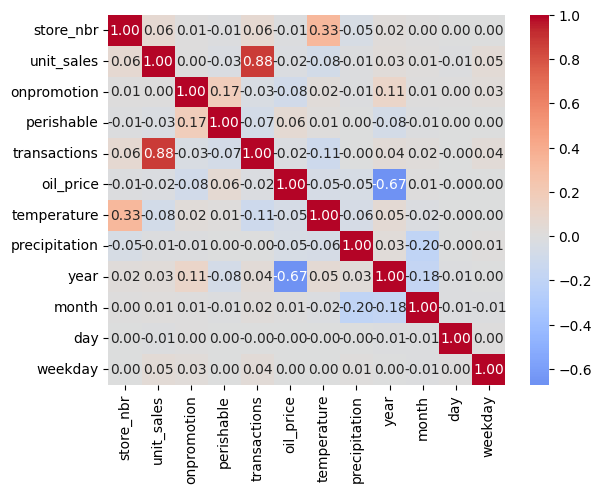

In [37]:
corr=df.select_dtypes('number').corr()
sns.heatmap(corr, cmap='coolwarm', center=0, annot=True, fmt='.2f')
plt.show()

In [38]:
df.select_dtypes('number').corr()

,store_nbr,unit_sales,onpromotion,perishable,transactions,oil_price,temperature,precipitation,year,month,day,weekday
store_nbr,1.000000,0.060392,0.005176,-0.005683,0.063851,-0.010916,0.331850,-0.049030,0.015288,0.003357,0.000414,0.000774
unit_sales,0.060392,1.000000,0.002518,-0.026216,0.882071,-0.020567,-0.081290,-0.005501,0.029375,0.014248,-0.014605,0.047159
onpromotion,0.005176,0.002518,1.000000,0.174920,-0.032641,-0.084954,0.021902,-0.005615,0.107335,0.007987,0.003381,0.032363
perishable,-0.005683,-0.026216,0.174920,1.000000,-0.074784,0.057191,0.008690,0.001375,-0.075529,-0.011422,0.001268,0.000941
transactions,0.063851,0.882071,-0.032641,-0.074784,1.000000,-0.023711,-0.112352,-0.003580,0.035042,0.016266,-0.003945,0.035288
oil_price,-0.010916,-0.020567,-0.084954,0.057191,-0.023711,1.000000,-0.054609,-0.045940,-0.670569,0.005735,-0.000996,0.000885
temperature,0.331850,-0.081290,0.021902,0.008690,-0.112352,-0.054609,1.000000,-0.057222,0.051372,-0.023982,-0.001556,0.001010
precipitation,-0.049030,-0.005501,-0.005615,0.001375,-0.003580,-0.045940,-0.057222,1.000000,0.029801,-0.199576,-0.004888,0.009307
year,0.015288,0.029375,0.107335,-0.075529,0.035042,-0.670569,0.051372,0.029801,1.000000,-0.176389,-0.014499,0.000173
month,0.003357,0.014248,0.007987,-0.011422,0.016266,0.005735,-0.023982,-0.199576,-0.176389,1.000000,-0.006230,-0.005450


In [39]:
df.head()

,date,store_nbr,family,unit_sales,onpromotion,city,state,store_type,perishable,transactions,oil_price,day_type,Event Scale,locale_name,temperature,precipitation,year,month,day,weekday
0,2016-02-18,29,HOME APPLIANCES,1.000,0,Guayaquil,Guayas,E,0,965,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
1,2016-02-18,29,HOME AND KITCHEN II,16.000,0,Guayaquil,Guayas,E,0,7720,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
2,2016-02-18,30,PRODUCE,499.029,0,Guayaquil,Guayas,C,1,55350,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3
3,2016-02-18,31,GROCERY II,10.000,0,Babahoyo,Los Rios,B,0,3702,30.77,Work Day,Non,Non,25.7,13.4,2016,2,18,3
4,2016-02-18,32,CLEANING,407.000,0,Guayaquil,Guayas,C,0,86196,30.77,Work Day,Non,Non,26.7,7.6,2016,2,18,3


In [40]:
avg_sales = df.groupby('store_type')['unit_sales'].mean().reset_index()

In [41]:
fig = px.bar(
    avg_sales,
    x='store_type',
    y='unit_sales',
    color='store_type',
    title='Average Unit Sales by Store Type',
    labels={'store_type': 'Store Type', 'unit_sales': 'Average Unit Sales'}
)
fig.show()

In [42]:
promo_sales = df[df['onpromotion'] == 1].groupby('store_type')['unit_sales'].mean()
no_promo_sales = df[df['onpromotion'] == 0].groupby('store_type')['unit_sales'].mean()

promo_comparison = pd.DataFrame({
    'Promo Sales': promo_sales,
    'No Promo Sales': no_promo_sales
}).reset_index()

In [43]:
fig = go.Figure(data=[
    go.Bar(name='With Promotion', x=promo_comparison['store_type'], y=promo_comparison['Promo Sales']),
    go.Bar(name='Without Promotion', x=promo_comparison['store_type'], y=promo_comparison['No Promo Sales'])
])
fig.update_layout(
    barmode='group',
    title='Promotion Impact on Unit Sales by Store Type',
    xaxis_title='Store Type',
    yaxis_title='Average Unit Sales'
)
fig.show()

In [44]:
store_counts = df['store_type'].value_counts().reset_index()
store_counts.columns = ['store_type', 'count']
fig = px.pie(
    store_counts,
    values='count',
    names='store_type',
    title='Store Type Distribution'
)
fig.show()

In [45]:
day_sales = df.groupby(['store_type', 'day_type'])['unit_sales'].mean().reset_index()
fig = px.bar(
    day_sales,
    x='store_type',
    y='unit_sales',
    color='day_type',
    barmode='group',
    title='Average Unit Sales by Store Type and Day Type',
    labels={'store_type': 'Store Type', 'unit_sales': 'Average Unit Sales', 'day_type': 'Day Type'}
)
fig.show()

In [46]:
perishable_sales = df.groupby('perishable')['unit_sales'].mean().reset_index()
perishable_sales['perishable'] = perishable_sales['perishable'].map({0: 'Non-Perishable', 1: 'Perishable'})


In [47]:
fig = px.bar(perishable_sales, x='perishable', y='unit_sales', color='perishable',
              title='Average Unit Sales: Perishable vs Non-Perishable',
              labels={'perishable': 'Product Type', 'unit_sales': 'Average Unit Sales'})
fig.show()

In [48]:
promo_p = df[df['onpromotion'] == 1].groupby('perishable')['unit_sales'].mean()
no_promo_p = df[df['onpromotion'] == 0].groupby('perishable')['unit_sales'].mean()

perishable_promo = pd.DataFrame({
    'Promo Sales': promo_p,
    'No Promo Sales': no_promo_p
}).reset_index()

In [49]:
fig = go.Figure(data=[
    go.Bar(name='With Promotion', x=perishable_promo['perishable'], y=perishable_promo['Promo Sales']),
    go.Bar(name='Without Promotion', x=perishable_promo['perishable'], y=perishable_promo['No Promo Sales'])
])
fig.update_layout(
    barmode='group',
    title='Promotion Impact: Perishable vs Non-Perishable',
    xaxis_title='Product Type',
    yaxis_title='Average Unit Sales'
)
fig.show()

In [50]:
perishable_counts = df['perishable'].value_counts().reset_index()
perishable_counts.columns = ['perishable', 'count']
perishable_counts['perishable'] = perishable_counts['perishable'].map({0: 'Non-Perishable', 1: 'Perishable'})


In [51]:
fig = px.pie(perishable_counts, values='count', names='perishable',
              title='Product Type Distribution (Perishable vs Non-Perishable)')
fig.show()

In [52]:
perishable_temp_sales = df.groupby(['perishable', 'temperature'])['unit_sales'].mean().reset_index()
perishable_temp_sales['perishable'] = perishable_temp_sales['perishable'].map({0: 'Non-Perishable', 1: 'Perishable'})


In [53]:
fig = px.line(
    perishable_temp_sales,
    x='temperature',
    y='unit_sales',
    color='perishable',
    title='Average Unit Sales by Temperature (Perishable vs Non-Perishable)',
    labels={'temperature': 'Temperature (°C)', 'unit_sales': 'Average Unit Sales'}
)
fig.show()

In [54]:
perishable_items = df[df['perishable'] == 1] 
fig = px.scatter(
    perishable_items,
    x='temperature',
    y='unit_sales',
    trendline='ols',  
    title='Temperature vs Unit Sales for Perishable Products',
    labels={'temperature': 'Temperature (°C)', 'unit_sales': 'Unit Sales'}
)
fig.show()

In [56]:
oil_price_bins = pd.cut(df['oil_price'], bins=5, labels=['Low', 'Medium Low', 'Medium', 'Medium High', 'High'])
df['oil_price_range'] = oil_price_bins
oil_price_sales = df.groupby('oil_price_range')['unit_sales'].mean().reset_index()

C:\Users\Ahmed\AppData\Local\Temp\ipykernel_2268\4201516003.py:3: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [57]:
fig = px.bar(
    oil_price_sales,
    x='oil_price_range',
    y='unit_sales',
    title='Average Unit Sales by Oil Price Range',
    labels={'oil_price_range': 'Oil Price Range', 'unit_sales': 'Average Unit Sales'}
)
fig.show()